In [1]:
import numpy as np
import pandas as pd

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df = pd.read_csv('bank.csv')
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,admin.,married,secondary,no,2343,yes,no,unknown,5,may,1042,1,-1,0,unknown,yes
1,56,admin.,married,secondary,no,45,no,no,unknown,5,may,1467,1,-1,0,unknown,yes
2,41,technician,married,secondary,no,1270,yes,no,unknown,5,may,1389,1,-1,0,unknown,yes
3,55,services,married,secondary,no,2476,yes,no,unknown,5,may,579,1,-1,0,unknown,yes
4,54,admin.,married,tertiary,no,184,no,no,unknown,5,may,673,2,-1,0,unknown,yes


In [4]:
df['convert'] = 0
df.loc[df['deposit'] == 'yes', 'convert'] = 1
df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit,convert
0,59,admin.,married,secondary,no,2343,yes,no,unknown,5,may,1042,1,-1,0,unknown,yes,1
1,56,admin.,married,secondary,no,45,no,no,unknown,5,may,1467,1,-1,0,unknown,yes,1
2,41,technician,married,secondary,no,1270,yes,no,unknown,5,may,1389,1,-1,0,unknown,yes,1
3,55,services,married,secondary,no,2476,yes,no,unknown,5,may,579,1,-1,0,unknown,yes,1
4,54,admin.,married,tertiary,no,184,no,no,unknown,5,may,673,2,-1,0,unknown,yes,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11157,33,blue-collar,single,primary,no,1,yes,no,cellular,20,apr,257,1,-1,0,unknown,no,0
11158,39,services,married,secondary,no,733,no,no,unknown,16,jun,83,4,-1,0,unknown,no,0
11159,32,technician,single,secondary,no,29,no,no,cellular,19,aug,156,2,-1,0,unknown,no,0
11160,43,technician,married,secondary,no,0,no,yes,cellular,8,may,9,2,172,5,failure,no,0


Стандартный синтаксис создания графика

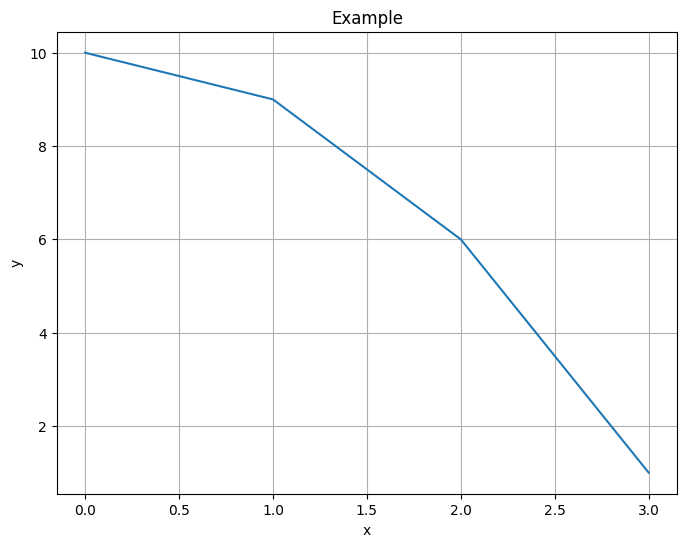

In [5]:
plt.figure(figsize=(8, 6)) # ширина и высота
plt.plot([0, 1, 2, 3], [10, 9, 6, 1]) # задаем точки по иксу и игреку
plt.xlabel('x') #название осей
plt.ylabel('y')
plt.title('Example') #название графика
plt.grid(); #сетка

## Виды графиков


### Линейный график

In [6]:
# Готовим данные для графика в виде сводной таблицы. Как много новых клиентов в зависимости от месяца

data = df.groupby('month')['job'].agg(count='count').reset_index().sort_values(by='month') # reset_index()  сброс индексов, счет по столбцу джоб
data.head()


,month,count
0,apr,923
1,aug,1519
2,dec,110
3,feb,776
4,jan,344


Matplotlib

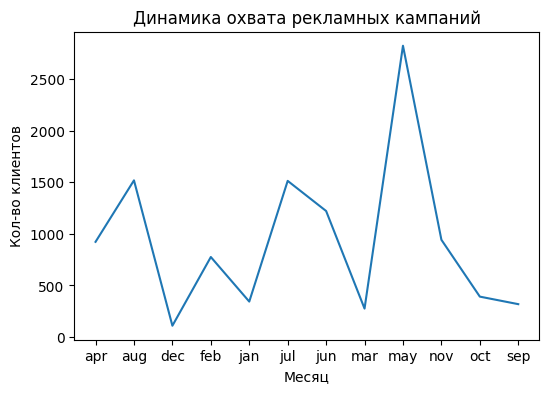

In [7]:
plt.figure(figsize=(6, 4))

plt.plot(data['month'], data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

Seaborn

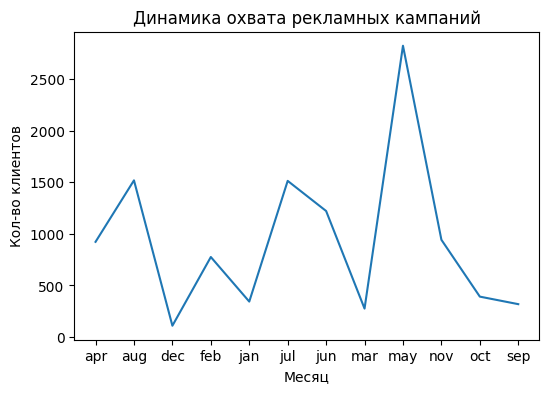

In [8]:
plt.figure(figsize=(6, 4))

sns.lineplot(x=data['month'], y=data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

## Гистограмма

### Matplotlib

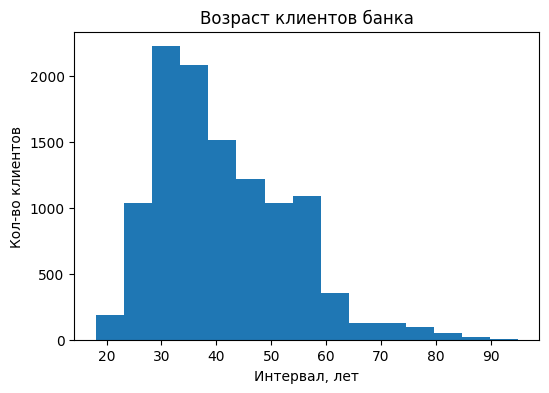

In [9]:
plt.figure(figsize=(6, 4))

plt.hist(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов'); # Text(0, 0.5, 'Кол-во клиентов') что бы убрать вывод нужно поставить ;

Бины - столбики, зависимость клиентов от возраста

Seaborn

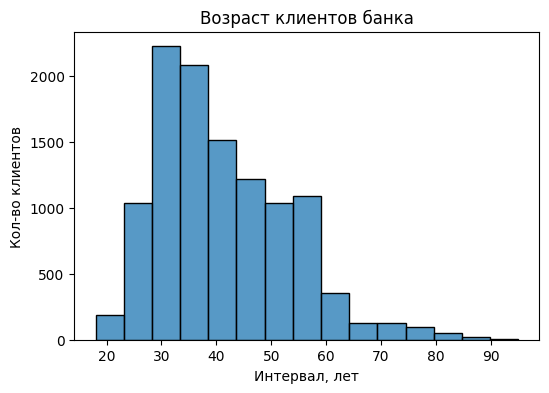

In [10]:
plt.figure(figsize=(6, 4))

sns.histplot(df['age'], bins=15) #на 15 бинов, столбиков

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

Диаграмма рассеяния

скатерплот - точечный график

посмотрим как часто совершал покупки в зависимости от возраста

In [11]:
# Готовим данные для графика в виде сводной таблицы
data = df.groupby('age')['deposit'].count().reset_index()
data.head()

,age,deposit
0,18,8
1,19,13
2,20,20
3,21,30
4,22,48


In [12]:
# Готовим данные для графика в виде сводной таблицы, группируем по возрасту и по наличию депозита, сброс индексов
data = df.groupby('age')['convert'].sum().reset_index()
data.head()

,age,convert
0,18,7
1,19,11
2,20,15
3,21,22
4,22,40


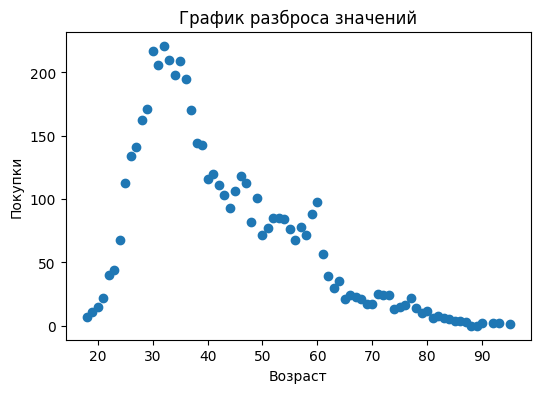

In [13]:
plt.figure(figsize=(6, 4))

plt.scatter(data['age'], data['convert'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

Seaborn

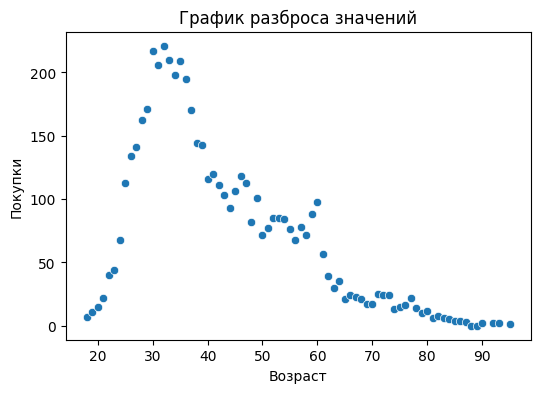

In [14]:
plt.figure(figsize=(6, 4))

sns.scatterplot(x=data['age'], y=data['convert'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

## Столбчатые диаграммы

 изучаем количество клиентов в зависимости от рода деятельности



In [15]:
# Готовим данные для графика
data = df['job'].value_counts().reset_index()
data.head()

,index,job
0,management,2566
1,blue-collar,1944
2,technician,1823
3,admin.,1334
4,services,923


Matplotlib

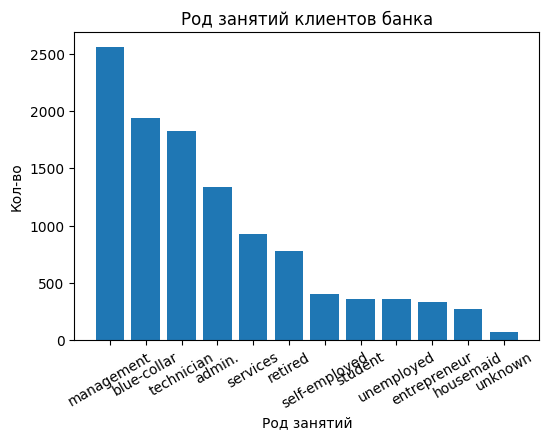

In [16]:
plt.figure(figsize=(6, 4))

plt.bar(data['index'], data['job']) # бар, столбчатая

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

Seaborn

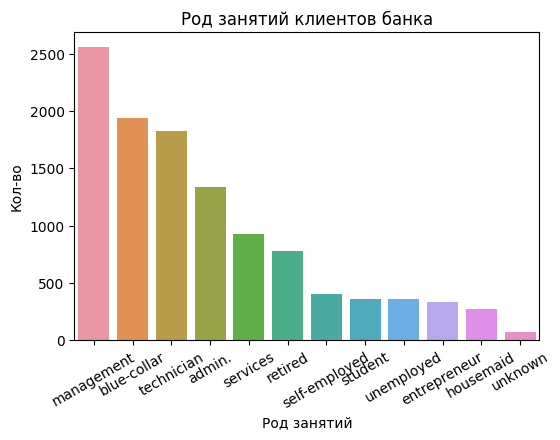

In [17]:
plt.figure(figsize=(6, 4))

sns.barplot(x=data['index'], y=data['job'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30); # rotation=30 -атрибут для наклона названий бинов

### Многорядовые столбчатые диаграммы

сколько людей брало депозиты или не брало в зависимости от должности

In [18]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['convert']).reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True) #переименовка названия стобцов
data.head()

convert,job,no,yes
4,management,1265,1301
1,blue-collar,1236,708
9,technician,983,840
0,admin.,703,631
7,services,554,369


In [22]:
data = pd.crosstab(df['job'], df['deposit']).reset_index().sort_values(by='no', ascending=False)
data.head()

deposit,job,no,yes
4,management,1265,1301
1,blue-collar,1236,708
9,technician,983,840
0,admin.,703,631
7,services,554,369


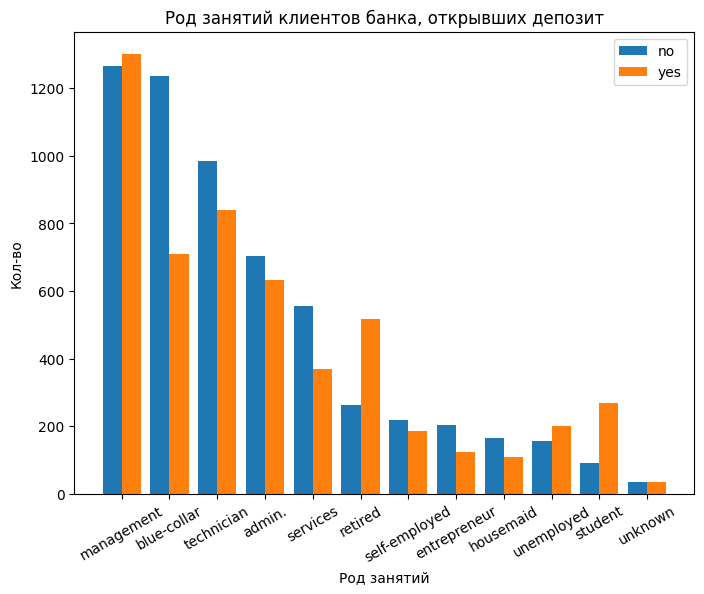

In [23]:
# Строим столбчатую многорядную диаграмму

plt.figure(figsize=(8, 6))

# определяем кол-во делений
n_ticks = np.arange(len(data['no']))

# определяем сдвиг
offset = 0.2

# определяем ширину столбцов
w = 0.4

# добавляем сдвиг к кол-ву делений
plt.bar(n_ticks - offset, data['no'], width=w) #синий
plt.bar(n_ticks + offset, data['yes'], width=w) # jhfy;tdsq

plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.legend(['no', 'yes'])
plt.xticks(n_ticks, data['job'], rotation = 30);  # добавляем метки деленя

### Сложенная столбчатая диаграмма

наложение, настакивать

изучаем как от рода деятельности меняетсч=ця кол-во клиентов открывших депозит

In [24]:
# Готовим данные для графика, нормализуем (перевод в доли) по строчно
data = pd.crosstab(df['job'], df['convert'], normalize='index').reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes
1,blue-collar,0.635802,0.364198
2,entrepreneur,0.625000,0.375000
3,housemaid,0.602190,0.397810
7,services,0.600217,0.399783
9,technician,0.539221,0.460779


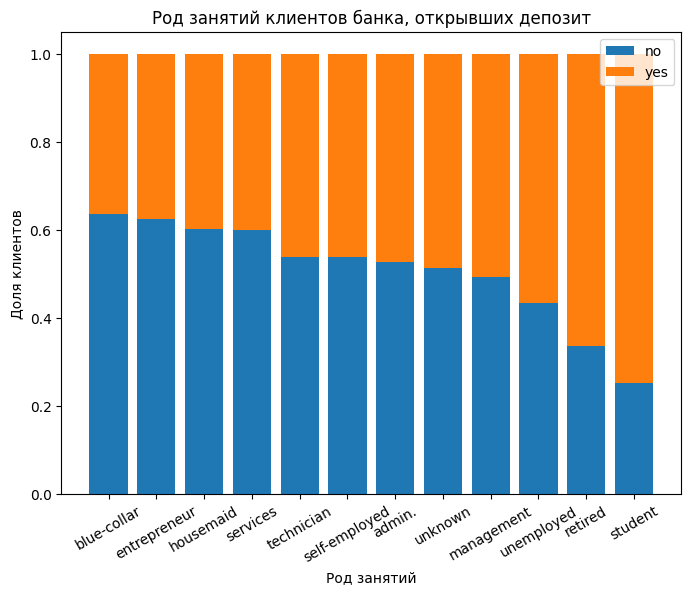

In [26]:
# Строим столбчатую многорядную сложенную диаграмму

plt.figure(figsize=(8, 6))

plt.bar(data['job'], data['no'])# рисуем синий
plt.bar(data['job'], data['yes'], bottom=data['no']) # рисуем оранжевый и указываем что он повер синего bottom=data['no']

plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Доля клиентов')
plt.legend(['no', 'yes'])
plt.xticks(rotation = 30);

Ящики с усами


In [29]:
# Готовим данные для графика
data1 = df['duration'][df['convert'] == 1] #признак длительности разговора с клиентом и конверсия
data2 = df['duration'][df['convert'] == 0]
data1

0       1042
1       1467
2       1389
3        579
4        673
        ... 
5284     335
5285     102
5286     138
5287     431
5288     151
Name: duration, Length: 5289, dtype: int64

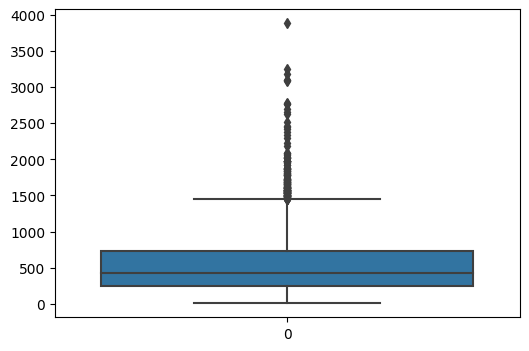

In [28]:
plt.figure(figsize=(6, 4))

sns.boxplot(data=[data1]);

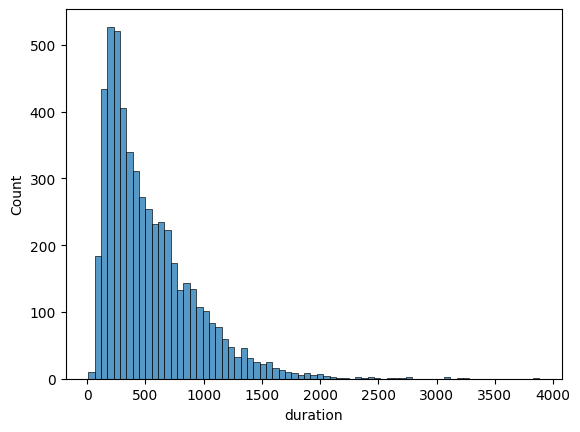

In [30]:
sns.histplot(x=data1);

Matplotlib стоим для наших данных

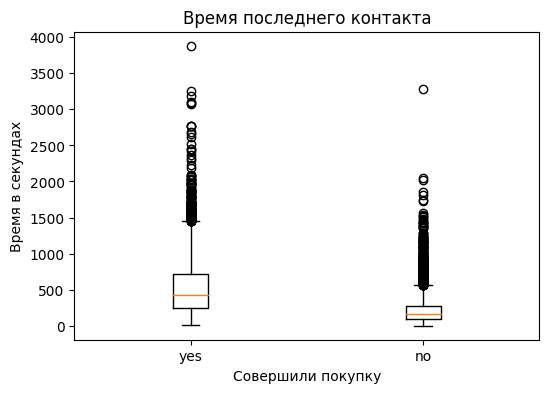

In [31]:
# Строим боксплот

plt.figure(figsize=(6, 4))

plt.boxplot([data1, data2])

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

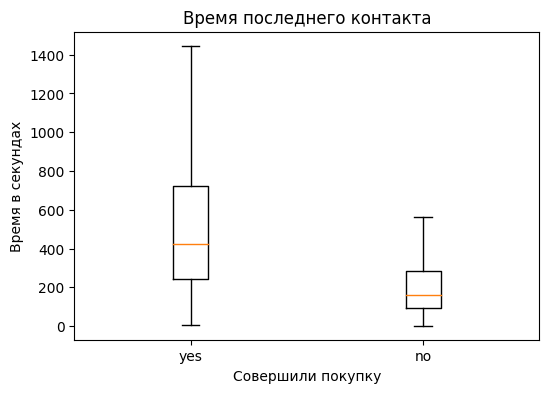

In [32]:
# Строим боксплот без выбросов 

plt.figure(figsize=(6, 4))

plt.boxplot([data1, data2], showfliers=False) # убрать выбросы showfliers=False

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')

plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

Вывод, общать с лиентами долго приводит к открытию депозита

Seaborn

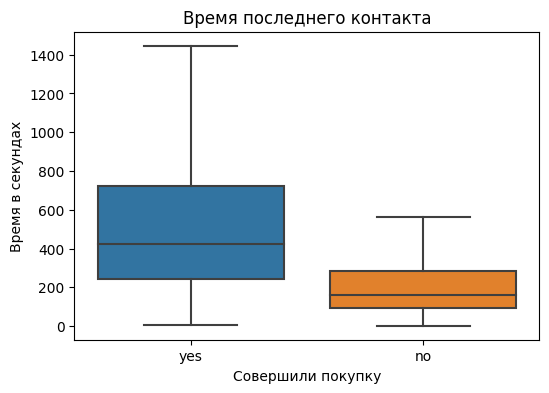

In [33]:
# Строим боксплот без выбросов 

plt.figure(figsize=(6, 4))

sns.boxplot(data=[data1, data2], showfliers=False) # убрать выбросы showfliers=False

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')

plt.ylabel('Время в секундах')
plt.xticks([0, 1], ['yes', 'no']);

### Круговая диаграмма

как часто ткрывали депозиты

In [34]:
# Готовим данные для графика
data = df['convert'].value_counts()
data.index = ['no', 'yes']
data.head()

no     5873
yes    5289
Name: convert, dtype: int64

Matplotlib

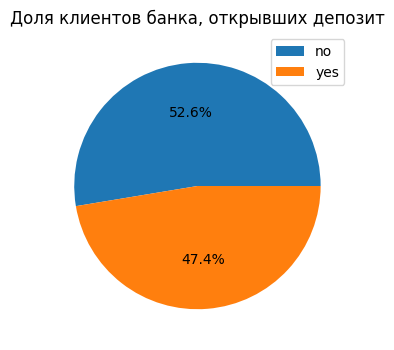

In [35]:
# Строим круговую диаграмму

plt.figure(figsize=(6, 4))

plt.pie(data, autopct='%1.1f%%') # добавление процентов

plt.title('Доля клиентов банка, открывших депозит')
plt.legend(data.index);

## Визуальный анализ данных
Описание датасета

Статистические данные о ряде домов в Калифорнии, основанные на переписи 1990 года.

longitude - долгота

latitude - широта

housing_median_age - средний возраст дома

total_rooms - общее количество комнат

total_bedrooms - общее количество спален

population - количество проживающих

households - домохозяйства

ocean_proximity - близость океана

median_income - средний доход

median_house_value - средняя стоимость дома

In [38]:
df = pd.read_csv('housing.csv', sep=',')
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


### Распределение вещественных признаков

In [ ]:
# {'red', 'green', 'blue'} - дискретный признак ('red', 'green', 'blue', 'red', 'green', 'red')
# [0, 100] - вещественный признак (0, 5, 5.6, 10.5, 10.57)

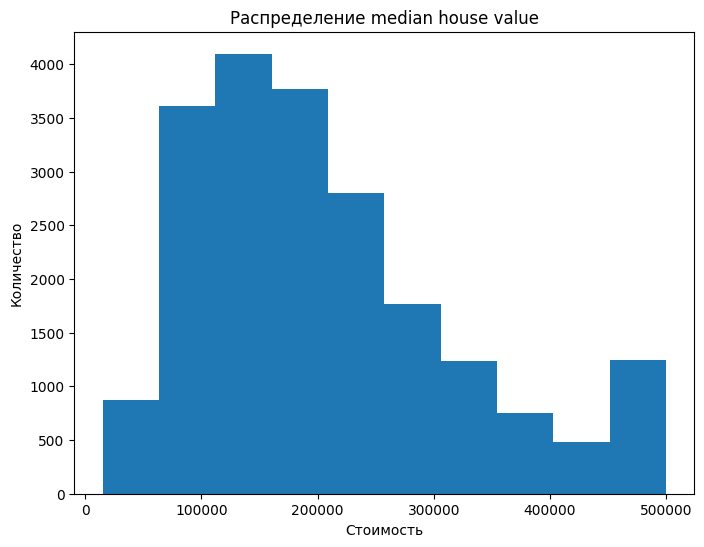

In [39]:
plt.figure(figsize=(8, 6))
plt.hist(df['median_house_value'])
plt.title('Распределение median house value')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

изучаем вещетвенные(числовые) признаки

In [40]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16']) # берем только числа
df_num_features.drop('median_house_value', axis=1, inplace=True) #убрали целивой признак

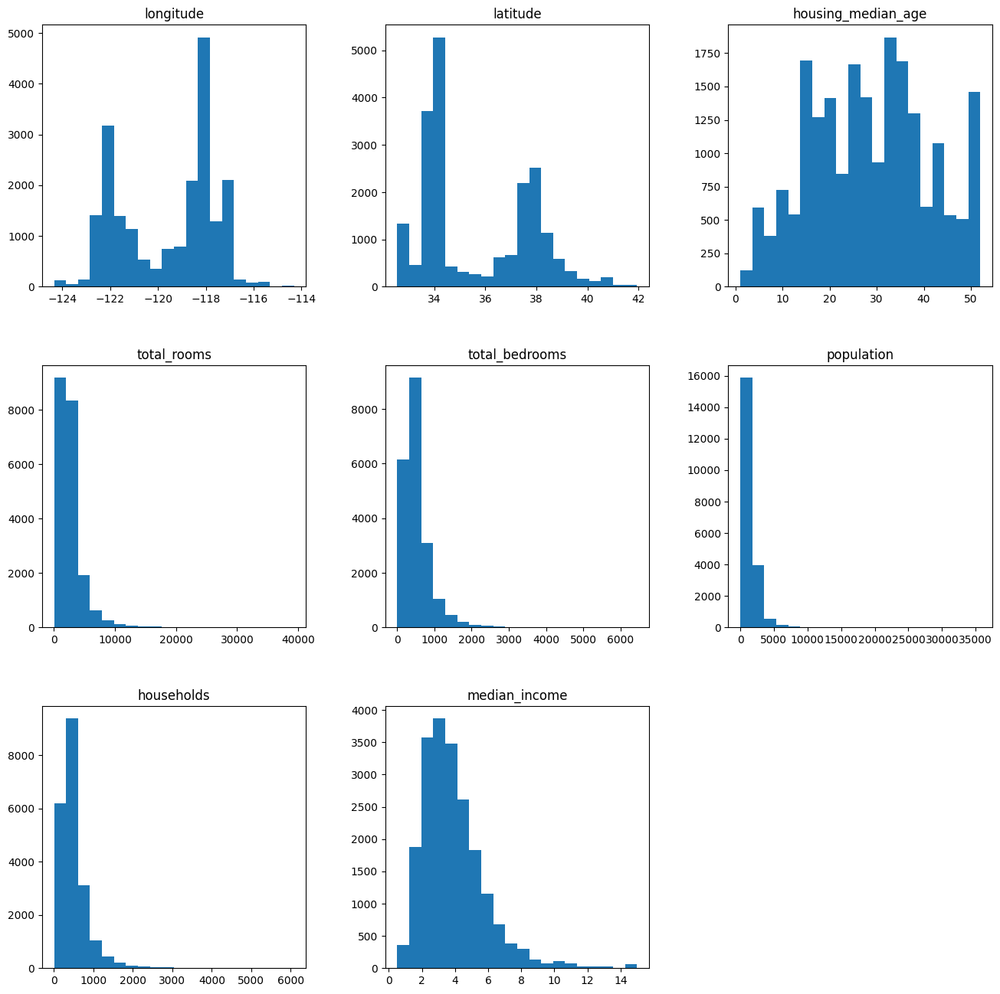

In [41]:
df_num_features.hist(figsize=(16, 16), bins=20, grid=False);

## Поиск выбросов с помощью box plot

### Как строится box plot

[Подробное объяснение]

* box - от 25% до 75% квантиля
* линия в середине box - медиана
* "усы"
### Как строятся "усы" - вариантов масса

* среднее +/- 3 сигма (стандартное отклонение)
* min / max
* median +/- 1.5*(q75 - q25),
* ...
* Интерквартильный размах = q75 - q25

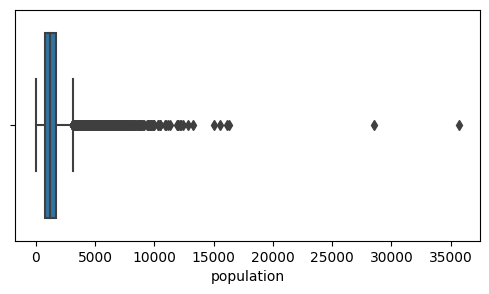

In [42]:
plt.figure(figsize=(6, 3))

sns.boxplot(x=df['population'], whis=1.5)

plt.xlabel('population')
plt.show()

Наличие выбросов

## Анализ категориальных признаков

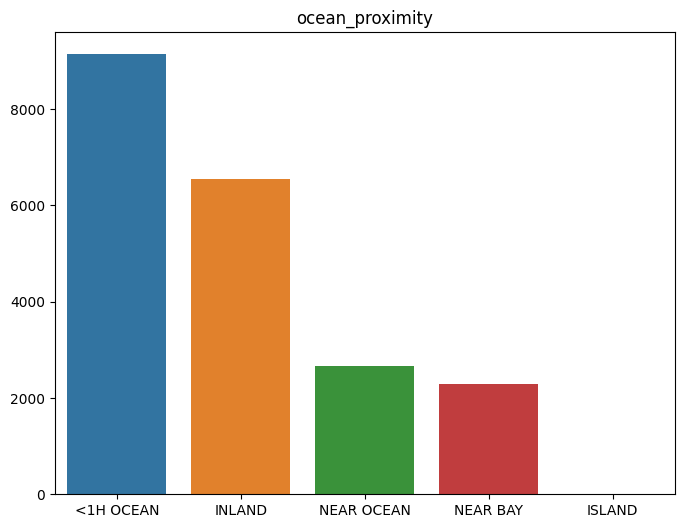

In [43]:
counts = df['ocean_proximity'].value_counts()
    
plt.figure(figsize=(8, 6))    
plt.title('ocean_proximity')
sns.barplot(x=counts.index, y=counts.values)
    
plt.show()

In [44]:
counts

<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: ocean_proximity, dtype: int64

In [50]:
df['INLAND'] = 1
df.loc[df['ocean_proximity'] == '<1H OCEAN', 'INLAND'] = 0
df.loc[df['ocean_proximity'] == 'INLAND', 'INLAND'] = 0

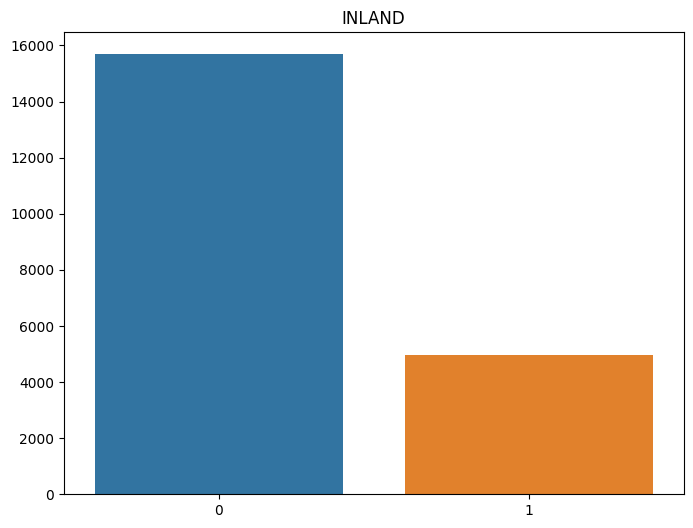

In [51]:
counts = df['INLAND'].value_counts()
    
plt.figure(figsize=(8, 6))    
plt.title('INLAND')
sns.barplot(x=counts.index, y=counts.values)
    
plt.show()

## Анализ взаимных распределений

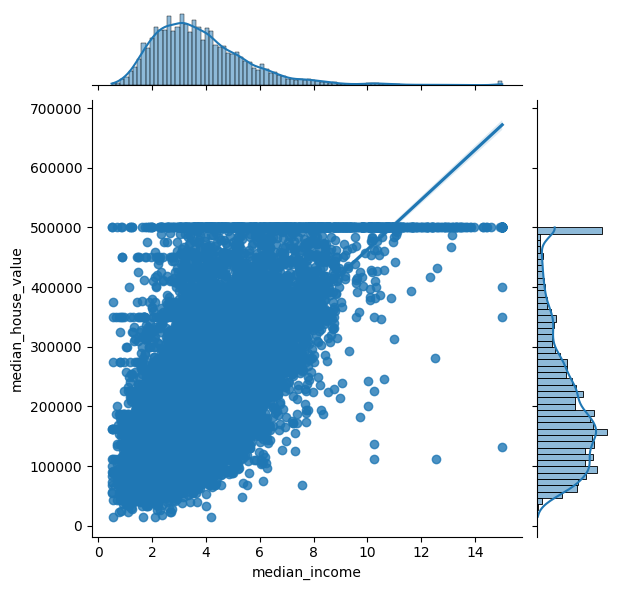

In [52]:
sns.jointplot(x=df['median_income'], y=df['median_house_value'], kind='reg');

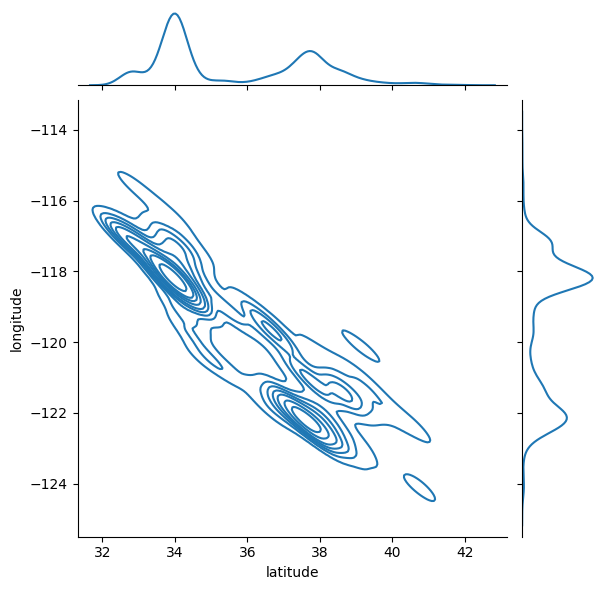

In [53]:
sns.jointplot(x=df['latitude'], y=df['longitude'], kind='kde'); #kde график

есть два города

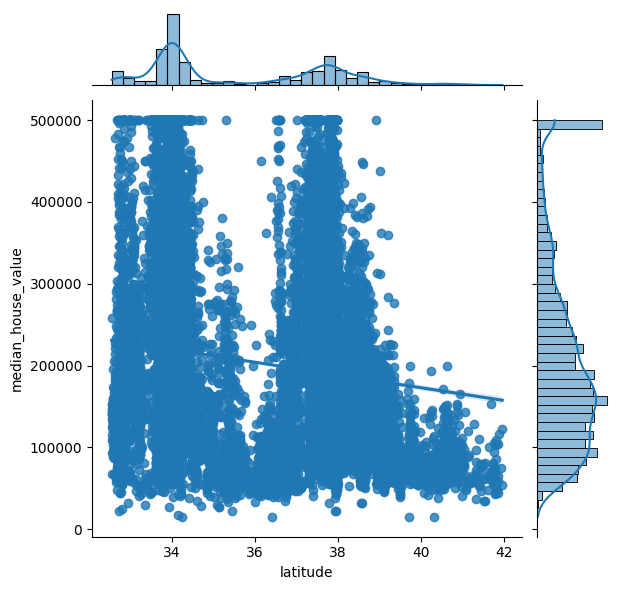

In [54]:
sns.jointplot(x=df['latitude'], y=df['median_house_value'], kind='reg');
#стоимость от широты

#### Видно два города, имеет смысл посмотреть на зависимость по отдельности

Берем широту до 36

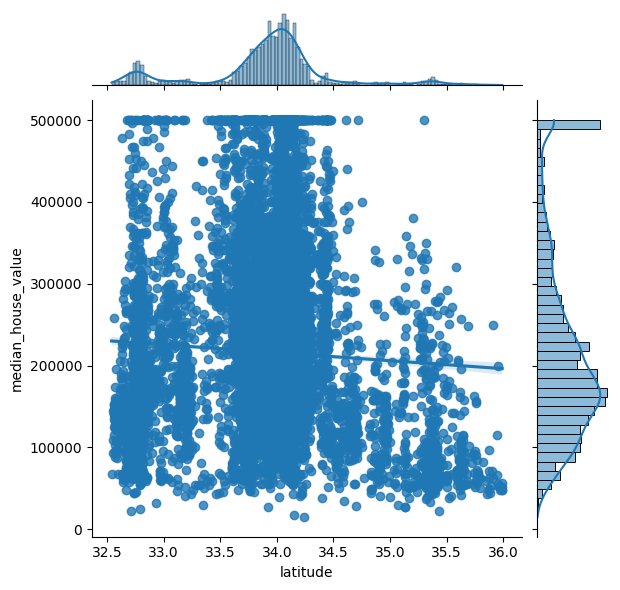

In [55]:
df_cut = df[df['latitude'] < 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

явной зависимости нет

возьмем широту больше 36

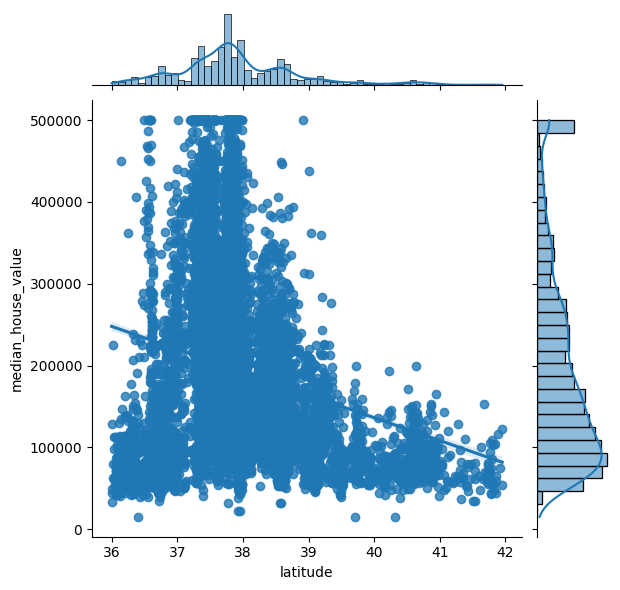

In [56]:
df_cut = df[df['latitude'] >= 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

есть небольшая зависимость стоимости от местаположения

#### longitude

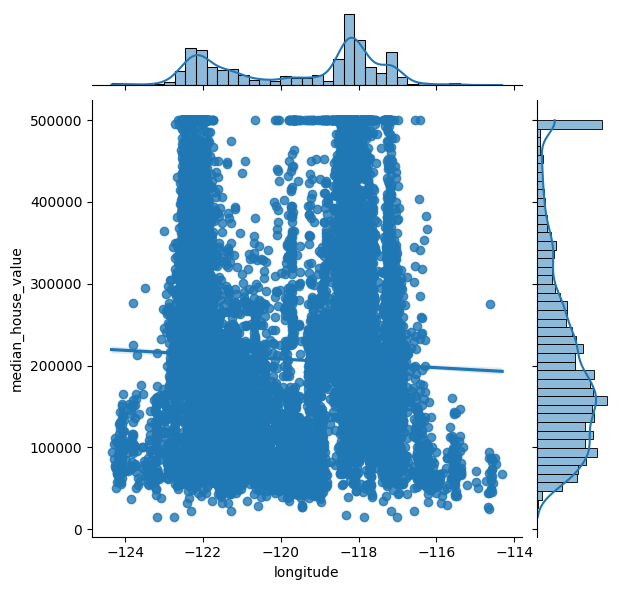

In [57]:
sns.jointplot(x=df['longitude'], y=df['median_house_value'], kind='reg');

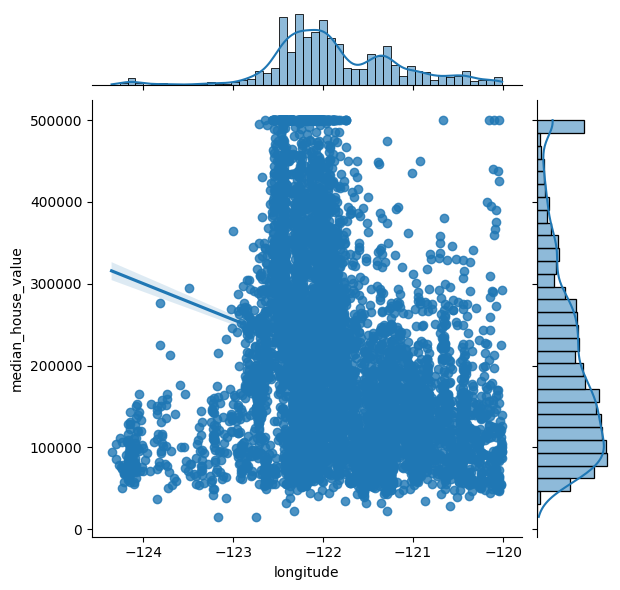

In [58]:
df_cut = df[df['longitude'] < -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

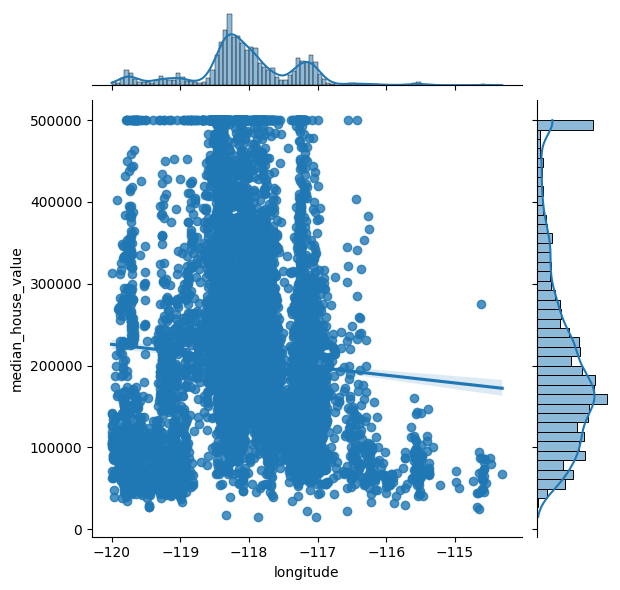

In [59]:
df_cut = df[df['longitude'] >= -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

### Категориальные / бинарные признаки

## box plot

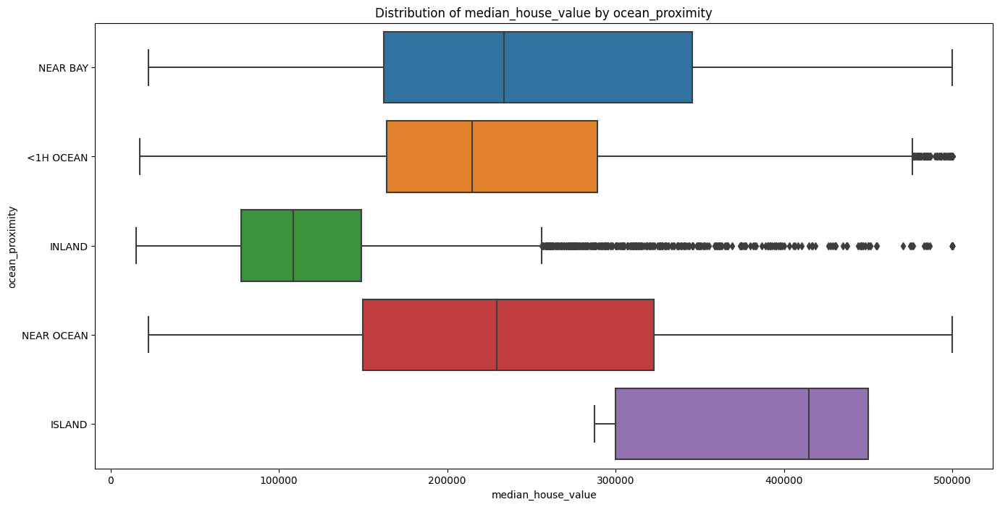

In [60]:
plt.figure(figsize=(16, 8))

sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5)

plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity');

очень дорогие на островах

Как строится box plot

Подробное объяснение

box - от 25% до 75% квантиля
линия в середине box - медиана
"усы"
Как строятся "усы" - вариантов масса

среднее +/- 3 сигма (стандартное отклонение)
min / max
median +/- 1.5*(q75 - q25),
...
*Интерквартильный размах = q75 - q25

## Матрица корреляций

* Показывает линейную связь между переменными
* Изменяется от -1 до 1
* Корреляция - мера только линейной связи

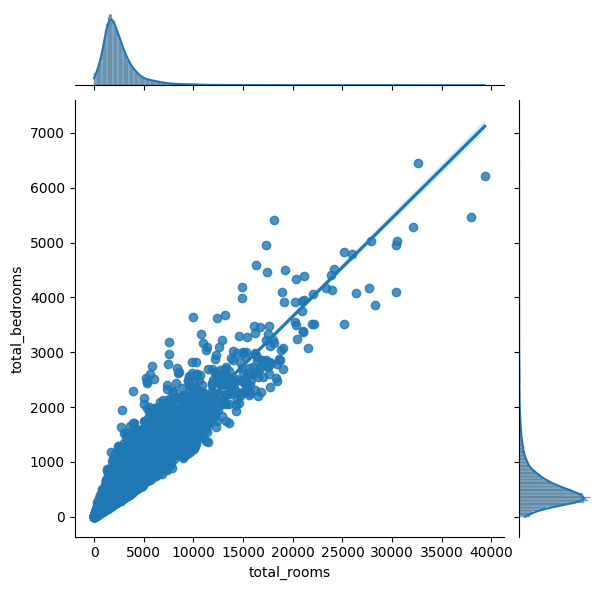

In [61]:
sns.jointplot(x=df['total_rooms'], y=df['total_bedrooms'], kind='reg');

идеальная прямая корреляция

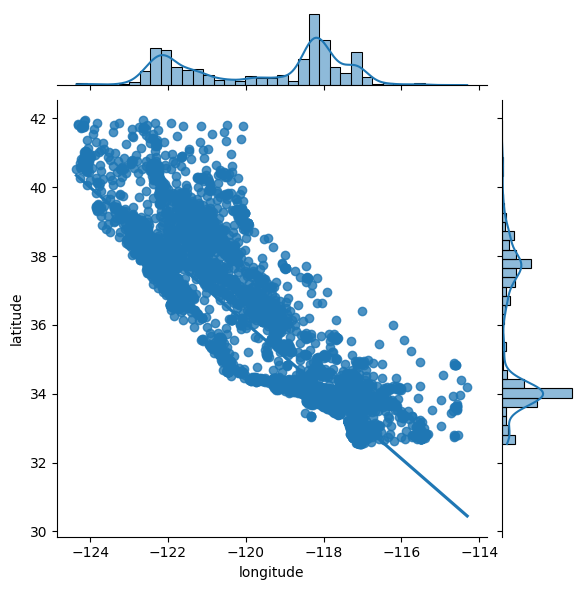

In [63]:
sns.jointplot(x=df['longitude'], y=df['latitude'], kind='reg');

обратная корреляция

## Можно построить матрицу корреляйций по всему датафрейму

In [64]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1) # округление
corr_matrix[np.abs(corr_matrix) < 0.3] = 0 # маленькие значения отрубаем
corr_matrix

/var/folders/3s/9xxqj9854x5d63mb_dq115ch0000gn/T/ipykernel_705/4194942596.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,INLAND
longitude,1.0,-0.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.3
latitude,-0.9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
housing_median_age,0.0,0.0,1.0,-0.4,-0.3,-0.3,-0.3,0.0,0.0,0.0
total_rooms,0.0,0.0,-0.4,1.0,0.9,0.9,0.9,0.0,0.0,0.0
total_bedrooms,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0,0.0
population,0.0,0.0,-0.3,0.9,0.9,1.0,0.9,0.0,0.0,0.0
households,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0,0.0
median_income,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.7,0.0
median_house_value,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7,1.0,0.0
INLAND,-0.3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


### Строим тепловую карту, есть только в СИБОРНЕ

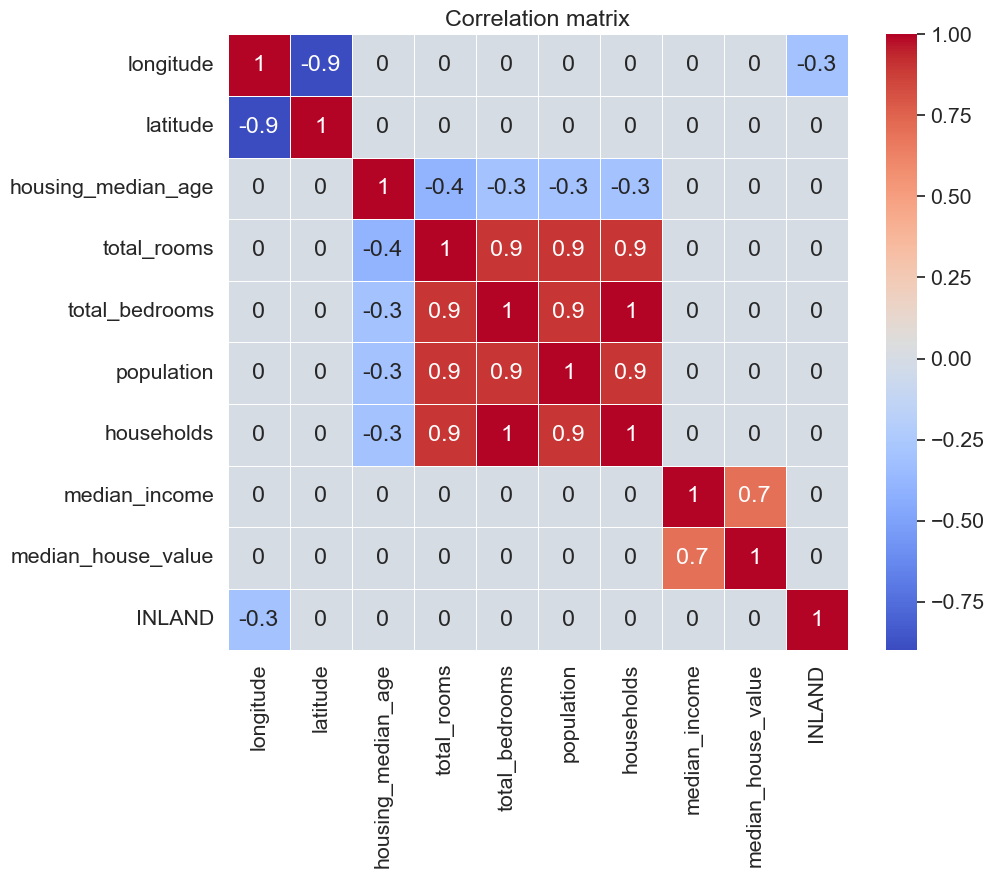

In [65]:
plt.figure(figsize=(10, 8))

sns.set(font_scale=1.4)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Correlation matrix');

## Гео данные


In [66]:
min_long = -124.55
max_long = -113.80

min_lat = 32.45
max_lat = 42.05

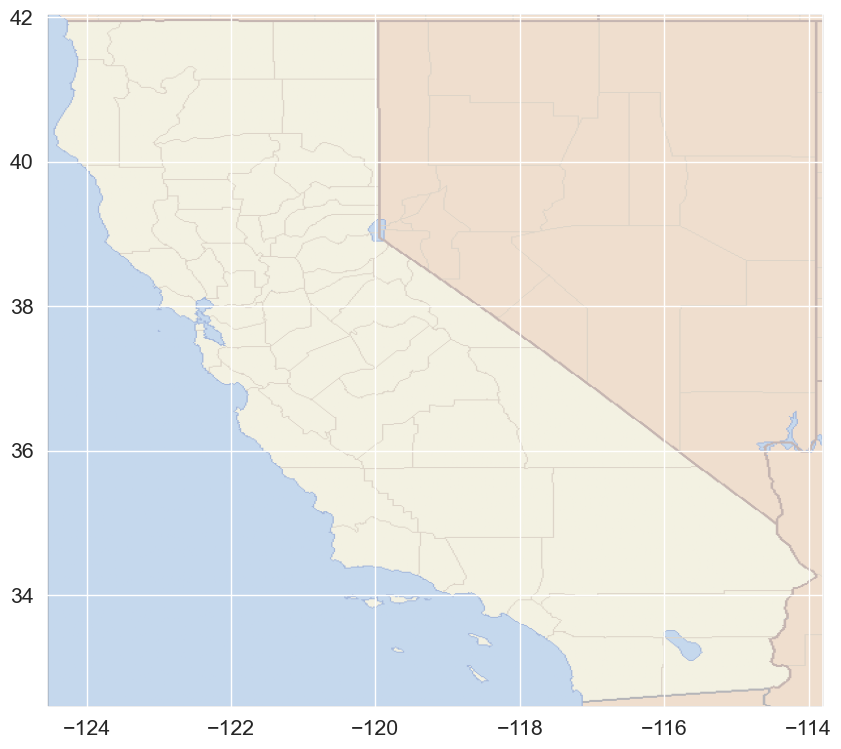

In [78]:
import matplotlib.image as img

california_map = img.imread('California_Map.png')

plt.figure(figsize=(12, 9))
plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5); #загоняем карту в наши координаты

теперь моджно нанести точки скатерплотом

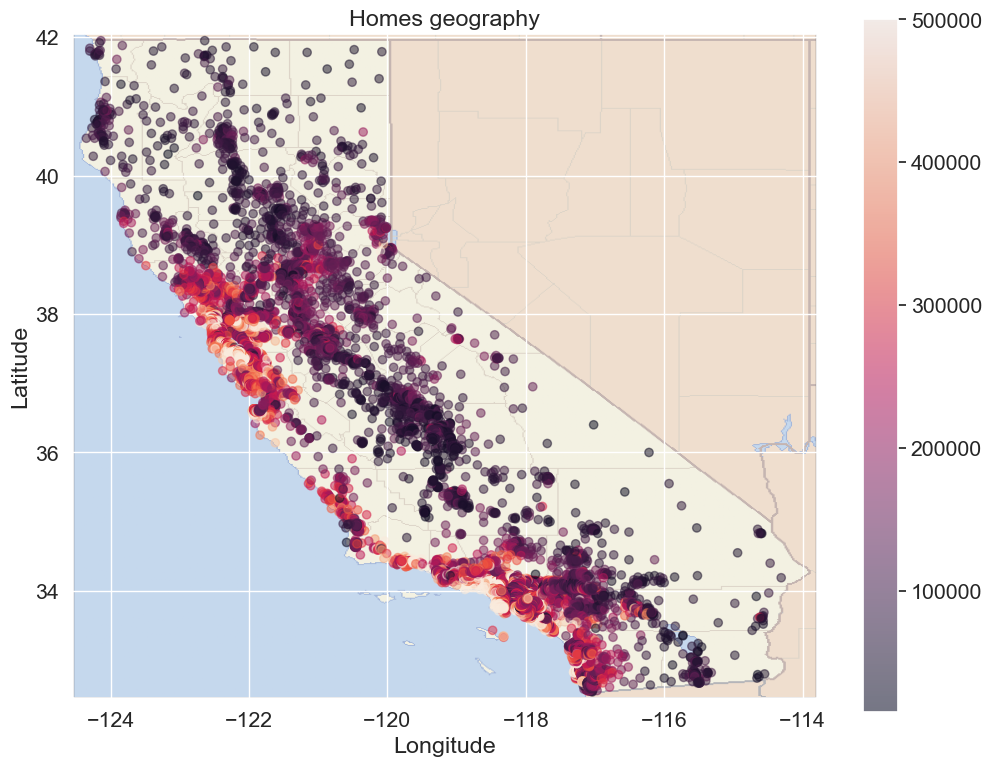

In [79]:
plt.figure(figsize=(12, 9))

sc = plt.scatter(df['longitude'], df['latitude'], alpha=0.5, c=df['median_house_value']) #alpha=0.5 полупрозрачная, c=df['median_house_value'] зависимость от цены

plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5) #подложка

plt.colorbar(sc)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Homes geography");

## Folium

для динамичных карт

In [80]:
import folium
this_map = folium.Map(prefer_canvas=True) #rfhnf

def plotDot(point): # нанесение точек
    folium.CircleMarker(
        location=[point.latitude, point.longitude],
        radius=2,
        popup=point.median_house_value # всплывающее значение на точке
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

### Еще один интерактивный инструмент

## Kepler**

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter
Map saved to ./california.html!

создаем обьект передав весь датафрей и сохраняем его в файл хтмл, потом открываем файл

можно сделать отрисовку по стоимости через меню в верхнем левом углу

In [81]:
from keplergl import KeplerGl 

map_ = KeplerGl(height=700)
map_.add_data(df, 'Data')
map_.save_to_html(file_name='./california.html')

User Guide: https://github.com/keplergl/kepler.gl/blob/master/docs/keplergl-jupyter/user-guide.md


/Users/maxim/Library/Python/3.9/lib/python/site-packages/jupyter_client/session.py:719: UserWarning: Message serialization failed with:
Out of range float values are not JSON compliant
Supporting this message is deprecated in jupyter-client 7, please make sure your message is JSON-compliant
  content = self.pack(content)


Map saved to ./california.html!


## Summary
1. Матрица корреляции
2. Знакомство с признаками
* Плотность распределения (sns.distplot/sns.kdeplot/plt.hist - Узнать распределение признака)
* sns.violinplot - Узнать распределение признака
* Столбчатая диаграмма (sns.barplot/plt.bar - Узнать распределение категориального признака)
* Ящик с усами (sns.boxplot/plt.boxplot - Узнать диапазон значений)
* sns.jointplot - Взаимное изменение признаков
* plt.pie - Изобразить долю объектов от всего кол-ва
3. Поиск выбросов
* sns.distplot/sns.kdeplot/plt.hist - Искать хвосты слева и справа
* sns.boxplot - Всё, что выходит за пределы усов - выбросы

Seaborn - https://seaborn.pydata.org/examples/index.html

Matplotlib - https://matplotlib.org/3.1.0/gallery/index.html